# Custom Training with YOLOv5

Tập hợp một tập dữ liệu về xe và đào tạo mô hình YOLOv5 tùy chỉnh để nhận ra các đối tượng trong tập dữ liệu  về xe cộ của chúng tôi. Nhóm sẽ thực hiện các bước sau:

* Tập hợp một bộ dữ liệu hình ảnh và dán nhãn bộ dữ liệu về xe cộ trên roboflow
* xuất bộ dữ liệu sang YOLOv5
* Train Yolov5 để nhận ra các đối tượng trong bộ dữ liệu
* Đánh giá hiệu suất của mô hình Yolov5 với tập data
* chạy test để xem mô hình làm việc thế nào



# Bước 1: cài đặt các yêu cầu và thư viện cần thiết

In [1]:
#clone YOLOv5 and 
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
!pip install -U -r requirements.txt # install dependencies
%pip install -q roboflow

import torch
import os
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Cloning into 'yolov5'...
remote: Enumerating objects: 12303, done.
remote: Counting objects: 100% (22/22), done.
remote: Compressing objects: 100% (20/20), done.
remote: Total 12303 (delta 7), reused 7 (delta 2), pack-reused 12281
Receiving objects: 100% (12303/12303), 12.12 MiB | 16.57 MiB/s, done.
Resolving deltas: 100% (8483/8483), done.
/content/yolov5
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 11.2 MB 35.2 MB/s 
     |████████████████████████████████| 60.9 MB 1.3 MB/s 
     |████████████████████████████████| 3.1 MB 49.2 MB/s 
     |████████████████████████████████| 596 kB 47.1 MB/s 
     |████████████████████████████████| 62 kB 1.9 MB/s 
     |████████████████████████████████| 38.1 MB 1.3 MB/s 
     |████████████████████████████████| 1.0 MB 59.4 MB/s 
     |████████████████████████████████| 5.8 MB 50.5 MB/s 
     |████████████████████████████████| 793 kB 58.9 MB/s 
     |███████████████

     |████████████████████████████████| 145 kB 48.5 MB/s 
     |████████████████████████████████| 178 kB 24.0 MB/s 
     |████████████████████████████████| 1.1 MB 50.6 MB/s 
     |████████████████████████████████| 67 kB 5.3 MB/s 
     |████████████████████████████████| 54 kB 3.3 MB/s 
     |████████████████████████████████| 138 kB 71.5 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-colab 1.0.0 requires ipython~=5.5.0, but you have ipython 7.34.0 which is incompatible.
google-colab 1.0.0 requires requests~=2.23.0, but you have requests 2.28.0 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.
Setup complete. Using torch 1.11.0+cu113 (Tesla T4)


# Bước 2: thêm thư viện roboflow và chuyển dữ liệu của mình vào colab ở định dạng thích hợp.

In [2]:
from roboflow import Roboflow
rf = Roboflow(model_format="yolov5", notebook="ultralytics")

upload and label your dataset, and get an API KEY here: https://app.roboflow.com/?model=yolov5&ref=ultralytics


In [3]:
# set up environment
os.environ["DATASET_DIRECTORY"] = "/content/datasets"

In [4]:
%cd /content/

/content


In [5]:
!curl -L "https://app.roboflow.com/ds/C5ahSYVmml?key=G48UkOTXyt" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

Kết quả truyền trực tuyến bị cắt bớt đến 5000 dòng cuối.
 extracting: train/images/IMG_6733_JPG_jpg.rf.83f371e8968118cd473d0cf7f51634be.jpg  
 extracting: train/images/IMG_6733_JPG_jpg.rf.dc777472e671d32507825a362e5c4cd6.jpg  
 extracting: train/images/IMG_6734_JPG_jpg.rf.07e05a5b6ab6a92b4cefeeee5e760ed9.jpg  
 extracting: train/images/IMG_6734_JPG_jpg.rf.ef1cbb0abab23f198565d0c7ef6c6d60.jpg  
 extracting: train/images/IMG_6735_JPG_jpg.rf.7a6ed75d9892f9588949d421fe709cc5.jpg  
 extracting: train/images/IMG_6735_JPG_jpg.rf.80fc8e4e15f84ece2420e352f8f546c0.jpg  
 extracting: train/images/IMG_6736_JPG_jpg.rf.7a5386fb30f7c0967f3b7c26587b5c29.jpg  
 extracting: train/images/IMG_6736_JPG_jpg.rf.bb300ac3b8b29158e6aa8a8a0c4c3296.jpg  
 extracting: train/images/IMG_6737_JPG_jpg.rf.338d7b3fd935e0d1a3730ea60a3fd8a5.jpg  
 extracting: train/images/IMG_6737_JPG_jpg.rf.b3f27370bf8924e401bebd7241b5a892.jpg  
 extracting: train/images/IMG_6738_JPG_jpg.rf.a5f47d20036ff62244b5b1a066884bcb.jpg  
 extract

# Bước 3: Huấn luyện mô hình Yolov5 tùy chỉnh

Các đối số:
- **img:** kích thước ảnh
- **batch:** số lượng mẫu dữ liệu trong một lần huấn luyện
- **epochs:** số vòng trainning.
- **data:** dữ liệu `dataset.location`
- **weights:**  path file pretrained đã tải
- **cache:** Hình ảnh bộ nhớ cache để đào tạo nhanh hơn

In [7]:
!python /content/yolov5/train.py --img 416 --batch 16 --epochs 150 --data /content/data.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=/content/data.yaml, hyp=yolov5/data/hyps/hyp.scratch-low.yaml, epochs=150, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=yolov5/runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-263-g0537e8d Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7

In [18]:
!python '/content/yolov5/val.py' --weights '/content/yolov5/runs/train/exp2/weights/best.pt' --data '/content/data.yaml'

val: data=/content/data.yaml, weights=['/content/yolov5/runs/train/exp2/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=yolov5/runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v6.1-263-g0537e8d Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 213 layers, 7023610 parameters, 0 gradients
val: Scanning '/content/yolov5/../valid/labels.cache' images and labels... 381 found, 0 missing, 0 empty, 0 corrupt: 100% 381/381 [00:00<?, ?it/s]
               Class     Images     Labels          P          R     mAP@.5 mAP@.5:.95: 100% 12/12 [00:09<00:00,  1.29it/s]
                 all        381       1105      0.792      0.696      0.763      0.479
             Bicycle        381         23       0.81      0.739      0.806      0.474
                 Bu

In [19]:
# Run YOLOv5x on COCO val
!python '/content/yolov5/val.py' --weights '/content/yolov5/runs/train/exp2/weights/best.pt' --data '/content/data.yaml' --img 416 --iou 0.65 --half

val: data=/content/data.yaml, weights=['/content/yolov5/runs/train/exp2/weights/best.pt'], batch_size=32, imgsz=416, conf_thres=0.001, iou_thres=0.65, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=yolov5/runs/val, name=exp, exist_ok=False, half=True, dnn=False
YOLOv5 🚀 v6.1-263-g0537e8d Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 213 layers, 7023610 parameters, 0 gradients
val: Scanning '/content/yolov5/../valid/labels.cache' images and labels... 381 found, 0 missing, 0 empty, 0 corrupt: 100% 381/381 [00:00<?, ?it/s]
               Class     Images     Labels          P          R     mAP@.5 mAP@.5:.95: 100% 12/12 [00:07<00:00,  1.66it/s]
                 all        381       1103      0.824      0.766      0.814      0.551
             Bicycle        381         23       0.91      0.876      0.921      0.621
                 Bu

# Đánh giá hiệu suất của Yolov5 detector
Mất mát đào tạo và số liệu hiệu suất được lưu vào Tensorboard và cũng cho một bản ghi nhật ký
Tập Trung vào  `mAP_0.5`

In [8]:
%load_ext tensorboard
%tensorboard --logdir /content/yolov5/runs

<IPython.core.display.Javascript object>

display.Image(f"

#Run Inference  With Trained Weights
chạy detect các ảnh trong thư mục test/images.

In [ ]:
!python /content/yolov5/detect.py --weights /content/yolov5/runs/train/exp/weights/best.pt --img 416 --conf 0.1 --source /content/test/images

detect: weights=['/content/yolov5/runs/train/exp/weights/best.pt'], source=/content/test/images, data=yolov5/data/coco128.yaml, imgsz=[416, 416], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=yolov5/runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-259-ga2a1ed2 Python-3.7.13 torch-1.11.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 213 layers, 7023610 parameters, 0 gradients
image 1/186 /content/test/images/102_jpg.rf.572c19b791ee7400e5770a9f10476db4.jpg: 416x416 6 Cars, Done. (0.009s)
image 2/186 /content/test/images/106_jpg.rf.27d23cf5db82490774bfa03fb9b2f1e6.jpg: 416x416 6 Cars, Done. (0.009s)
image 3/186 /content/test/images/116_jpg.rf.97dfd73af46e64d3aa033035e8f04a2c.jpg: 416x416 8 Cars, Done. (0.009s)
imag

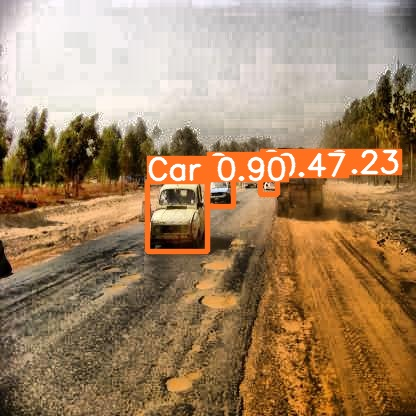

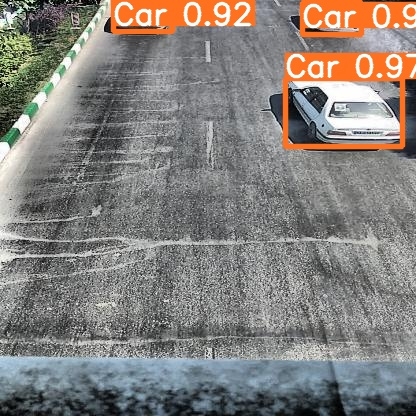

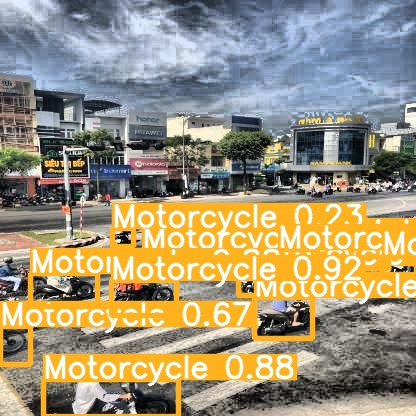

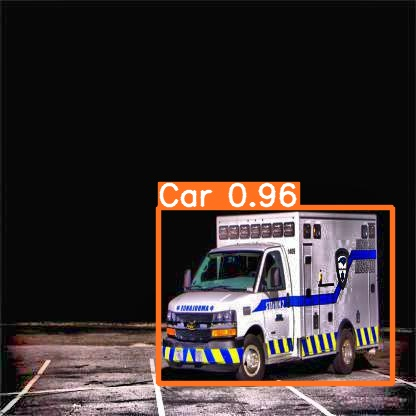

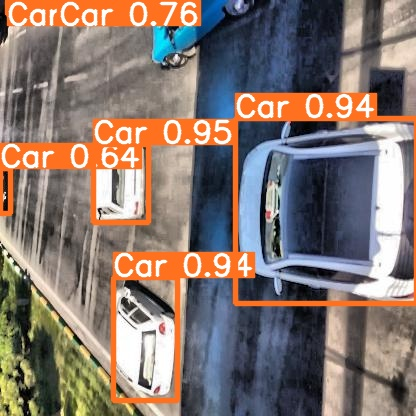

...

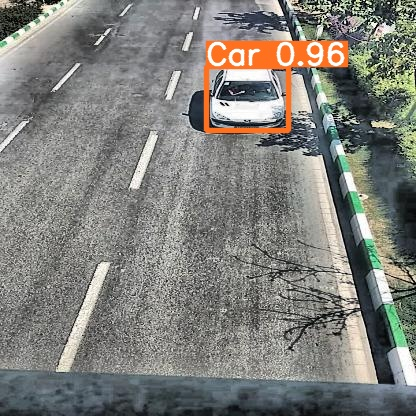

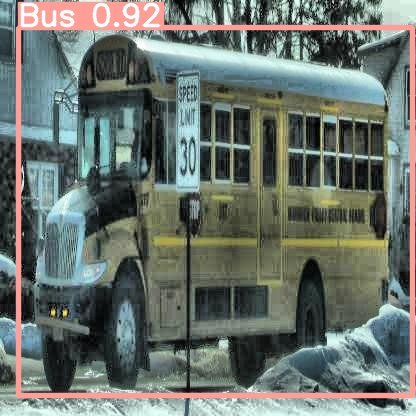

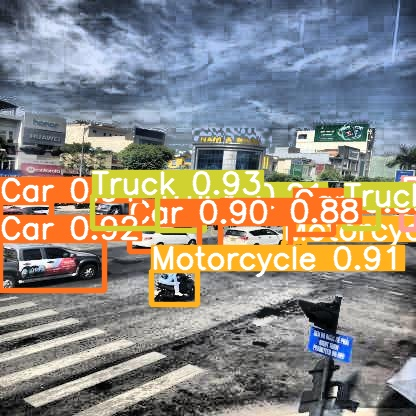

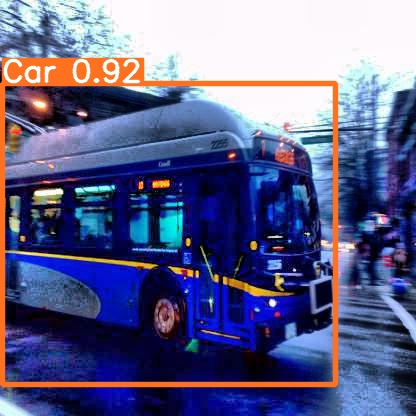

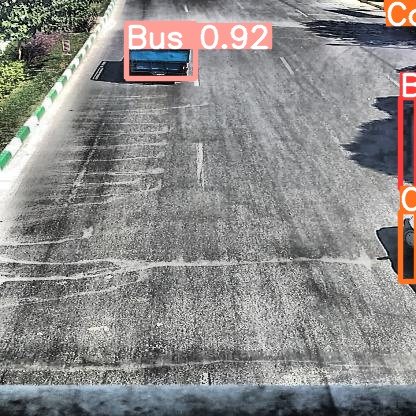

In [ ]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

# Cuối cùng

Kết nối với drive và lưu kết quả khi thực hiện train và detect model

In [10]:
#export your model's weights for future use
from google.colab import files
files.download('/content/yolov5/runs/train/exp2/weights/best.pt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [11]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [16]:
%cp -r /content/yolov5/ /content/drive/My\ Drive